In [17]:
%load_ext autoreload
%autoreload 2
%env WANDB_SILENT=true

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
env: WANDB_SILENT=true


In [18]:
import torch
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure, LearnedPerceptualImagePatchSimilarity
import utils
from models import UNetMod, UNetModECA, FC_ECA, FC_ECA1, UNetModBN
from denoisers.dip import DIP, DDIP, SGDIP, PatchDIP, losses, schedules

Files already downloaded and verified


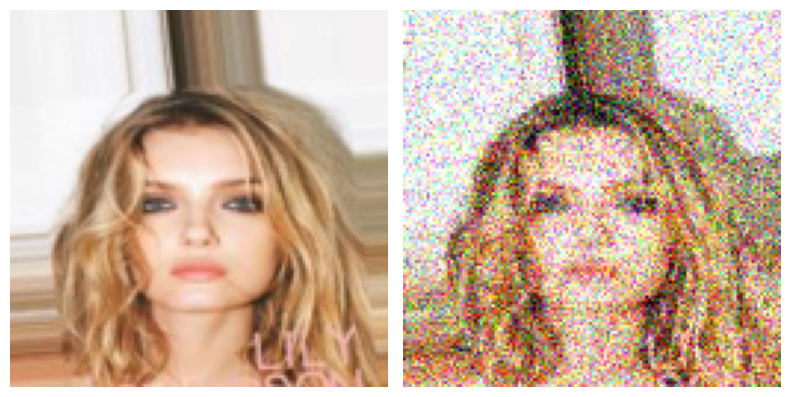

tensor(15.0016)


In [19]:
clean = utils.load_celeba(20)
# clean = utils.load_images('./data/image/CBSD68/')[:30]
# clean = utils.load_images('./data/image/Set14/')
# clean = utils.load_image("./data/image/set5/butterfly.png")
noisy = torch.stack([utils.get_noisy_image(img, 15) for img in clean])

utils.plot_row([clean[0], noisy[0]])

psnr = PeakSignalNoiseRatio(data_range=2)
print(psnr(noisy, clean))

In [20]:
# networks
net = UNetMod(hidden_ch=8, n_layers=4)
net_bn = UNetModBN(hidden_ch=8, n_layers=4)
net1 = UNetModECA(hidden_ch=8, n_layers=4)
net2 = UNetModECA(hidden_ch=64, n_layers=2)
net3 = FC_ECA(3*24*24, freeze=False)
net4 = FC_ECA1(3*24*24, freeze=False)

# schedules
linear = schedules.Linear(1, 10)
cos = schedules.Cos(0.1, 0.9)

# losses
mse = losses.MSE()
nmse = losses.NMSE()

mse_ae = losses.Compose(losses.MSE(), losses.AE())
nmse_ae = losses.Compose(losses.NMSE(), losses.AE())

mse_tv = losses.Compose(losses.MSE(), losses.TV(), alpha=0.1)
nmse_tv = losses.Compose(losses.NMSE(), losses.TV(), alpha=0.1)

# variants
dip = DIP(net, losses.MSE())
dip_es = DIP(net, losses.MSE(), early_stopping=True)
dip_neighbor = DIP(net, losses.NMSE())
dip_neighbor_es = DIP(net, losses.NMSE(), early_stopping=True)
dip_tv = DIP(net, mse_tv)
dip_tv_es = DIP(net, mse_tv, early_stopping=True)

sgdip = SGDIP(net, mse_ae)
sgdip_es = SGDIP(net, mse_ae, early_stopping=True)
sgdip_neighbor = SGDIP(net, nmse_ae)
sgdip_neighbor_es = SGDIP(net, nmse_ae, early_stopping=True)

ddip = DDIP(net, losses.MSE(), cos)
ddip_3 = DDIP(net, losses.MSE(), cos, k=3)
ddip_neighbor = DDIP(net, losses.NMSE(), cos)

patch_dip = PatchDIP(net2, losses.MSE(), epochs=20, threshold=0.2)
patch_dip2 = PatchDIP(net4, losses.MSE(), epochs=20, threshold=0.2)

d:\Code\ML\zero-shot-das-denoising\.venv\Lib\site-packages\torch\nn\init.py:511: UserWarning: Initializing zero-element tensors is a no-op
  warnings.warn("Initializing zero-element tensors is a no-op")


In [21]:
denoisers = [
    # sgdip_neighbor_es,
    # dip,
    DIP(net, losses.MSE(), early_stopping=True),
    DIP(net_bn, losses.MSE(), early_stopping=True),
    # sgdip,
    # SGDIP(net, mse_ae.with_alpha(linear)),
    # SGDIP(net, nmse_ae.with_alpha(linear)),
    # dip_es,
    # dip_tv,
    # DIP(net, mse_tv.with_alpha(1)),
    # ddip,
    # ddip_neighbor,
    # patch_dip2,
    # DIP(net1, mse, early_stopping=True),
    # dip_tv_es,
    # SGDIP(net, mse_ae, max_epochs=2000, early_stopping=False),
    # SGDIP(net1, mse_ae, max_epochs=2000, early_stopping=True),
    # SGDIP(net, mse_ae.with_alpha(linear), max_epochs=2000),
    # SGDIP(net1, mse_ae.with_alpha(linear), max_epochs=2000),
    # SGDIP(net1, mse_ae.with_alpha(linear), max_epochs=1000),
    # SGDIP(net1, mse_ae.with_alpha(linear), max_epochs=2000),
    # sgdip_es
    # SGDIP(net1, mse_ae, early_stopping=True),
    # SGDIP(net1, mse_ae.with_alpha(linear)),
    # SGDIP(net1, nmse_ae.with_alpha(linear)),
    # DDIP(net1, mse, cos),
    # DIP(net, mse, early_stopping=True),
    # SGDIP(net, mse_ae, early_stopping=True),
    # SGDIP(net, mse_ae.with_alpha(linear)),
    # SGDIP(net, nmse_ae.with_alpha(linear)),
    # DDIP(net, mse, cos),
]

metrics = {
    "psnr": PeakSignalNoiseRatio(data_range=2),
    "ssim": StructuralSimilarityIndexMeasure(data_range=2),
}

results = {}
for i, denoiser in enumerate(denoisers):
    outputs = []
    for j, (y, x) in enumerate(zip(noisy, clean)):
        options = {
            "mode": "wandb",
            "config": {
                "out_dir": "output/videos",
                "project": "zero-shot-das-denoising",
                "entity": "jmaen-team",
                "group": "bn vs in",
                "dataset": "cbsd68-15",
                "denoiser_id": i + 4,
                "data_id": j,
            },
            "metrics": metrics,
            "log_output": False,
        }
        output, _, _ = denoiser.denoise(y.unsqueeze(0), x.unsqueeze(0), options, {"reference": y.unsqueeze(0)})
        output = output.detach().clone().cpu()
        outputs.append(output)

    results[f"{i} - {denoiser.name()}"] = torch.cat(outputs)

Running: 0 - DIP - ES - MSE - UNetMod 


 33%|███▎      | 664/2000 [00:27<00:55, 24.09it/s]


Running: 1 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 554/2000 [00:23<01:00, 23.98it/s]


Running: 2 - DIP - ES - MSE - UNetMod 


 29%|██▊       | 573/2000 [00:23<00:58, 24.20it/s]


Running: 3 - DIP - ES - MSE - UNetMod 


 29%|██▉       | 583/2000 [00:23<00:55, 25.34it/s]


Running: 4 - DIP - ES - MSE - UNetMod 


 26%|██▋       | 528/2000 [00:21<01:01, 24.10it/s]


Running: 5 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 537/2000 [00:22<01:00, 24.17it/s]


Running: 6 - DIP - ES - MSE - UNetMod 


 32%|███▏      | 641/2000 [00:26<00:56, 24.26it/s]


Running: 7 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 558/2000 [00:23<01:00, 23.79it/s]


Running: 8 - DIP - ES - MSE - UNetMod 


 31%|███       | 622/2000 [00:25<00:56, 24.49it/s]


Running: 9 - DIP - ES - MSE - UNetMod 


 29%|██▉       | 585/2000 [00:23<00:56, 25.09it/s]


Running: 10 - DIP - ES - MSE - UNetMod 


 30%|███       | 607/2000 [00:25<00:58, 23.93it/s]


Running: 11 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 565/2000 [00:23<00:58, 24.41it/s]


Running: 12 - DIP - ES - MSE - UNetMod 


 33%|███▎      | 653/2000 [00:26<00:54, 24.71it/s]


Running: 13 - DIP - ES - MSE - UNetMod 


 29%|██▊       | 571/2000 [00:23<00:59, 23.98it/s]


Running: 14 - DIP - ES - MSE - UNetMod 


 26%|██▌       | 511/2000 [00:22<01:04, 23.03it/s]


Running: 15 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 539/2000 [00:22<01:01, 23.83it/s]


Running: 16 - DIP - ES - MSE - UNetMod 


 33%|███▎      | 666/2000 [00:27<00:55, 23.86it/s]


Running: 17 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 553/2000 [00:23<01:00, 23.95it/s]


Running: 18 - DIP - ES - MSE - UNetMod 


 33%|███▎      | 658/2000 [00:26<00:54, 24.64it/s]


Running: 19 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 550/2000 [00:23<01:02, 23.36it/s]


Running: 0 - DIP - ES - MSE - UNetMod 


 31%|███▏      | 626/2000 [00:27<00:59, 23.14it/s]


Running: 1 - DIP - ES - MSE - UNetMod 


 31%|███       | 623/2000 [00:27<01:00, 22.86it/s]


Running: 2 - DIP - ES - MSE - UNetMod 


 30%|██▉       | 593/2000 [00:27<01:04, 21.87it/s]


Running: 3 - DIP - ES - MSE - UNetMod 


 31%|███       | 614/2000 [00:26<01:00, 22.82it/s]


Running: 4 - DIP - ES - MSE - UNetMod 


 34%|███▎      | 670/2000 [00:29<00:59, 22.37it/s]


Running: 5 - DIP - ES - MSE - UNetMod 


 29%|██▊       | 572/2000 [00:25<01:03, 22.34it/s]


Running: 6 - DIP - ES - MSE - UNetMod 


 30%|██▉       | 598/2000 [00:26<01:01, 22.66it/s]


Running: 7 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 567/2000 [00:25<01:03, 22.40it/s]


Running: 8 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 545/2000 [00:24<01:04, 22.52it/s]


Running: 9 - DIP - ES - MSE - UNetMod 


 25%|██▌       | 508/2000 [00:21<01:02, 23.82it/s]


Running: 10 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 561/2000 [00:23<00:59, 24.15it/s]


Running: 11 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 551/2000 [00:24<01:04, 22.63it/s]


Running: 12 - DIP - ES - MSE - UNetMod 


 28%|██▊       | 562/2000 [00:24<01:02, 23.08it/s]


Running: 13 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 546/2000 [00:23<01:02, 23.34it/s]


Running: 14 - DIP - ES - MSE - UNetMod 


 30%|██▉       | 595/2000 [00:25<00:59, 23.72it/s]


Running: 15 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 543/2000 [00:23<01:02, 23.22it/s]


Running: 16 - DIP - ES - MSE - UNetMod 


 31%|███       | 617/2000 [00:26<00:59, 23.40it/s]


Running: 17 - DIP - ES - MSE - UNetMod 


 27%|██▋       | 543/2000 [00:23<01:03, 22.89it/s]


Running: 18 - DIP - ES - MSE - UNetMod 


 30%|███       | 602/2000 [00:25<00:59, 23.45it/s]


Running: 19 - DIP - ES - MSE - UNetMod 


 29%|██▊       | 572/2000 [00:24<01:00, 23.69it/s]


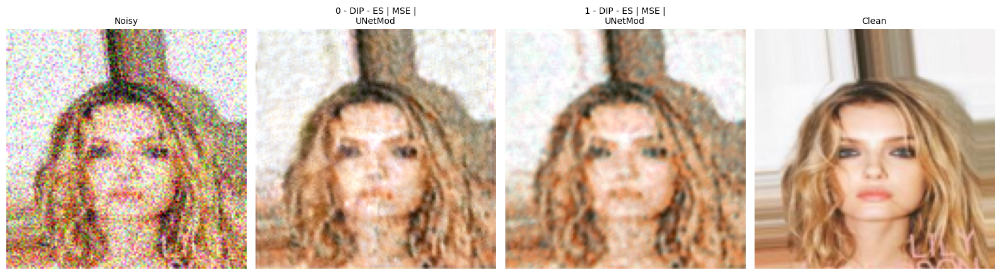

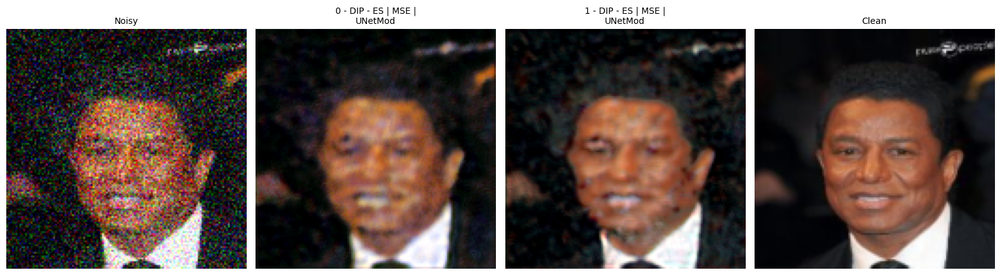

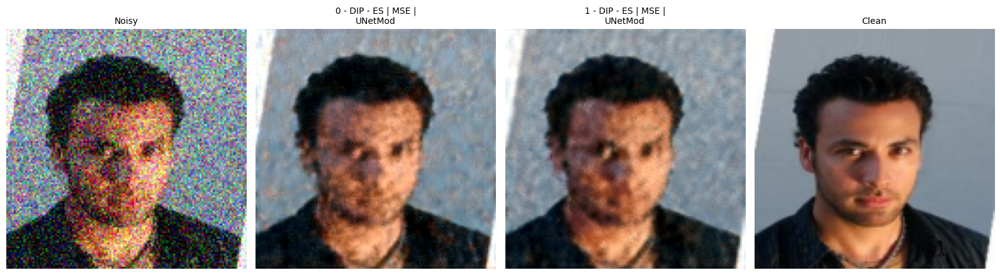

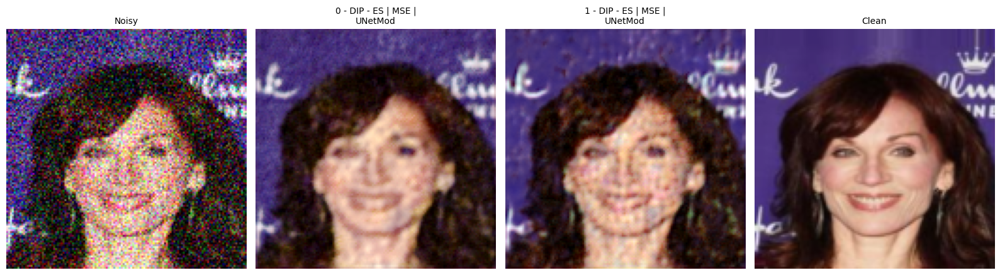

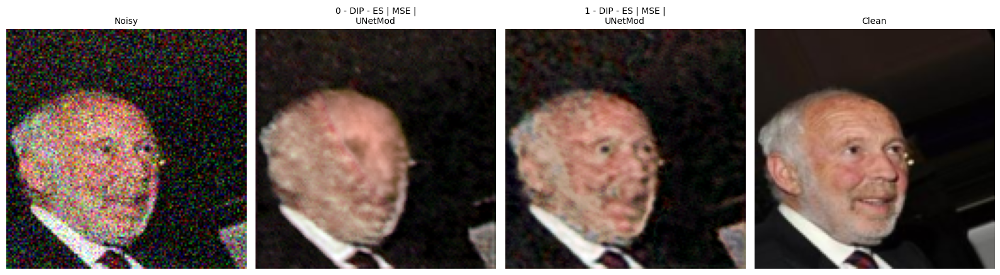

...

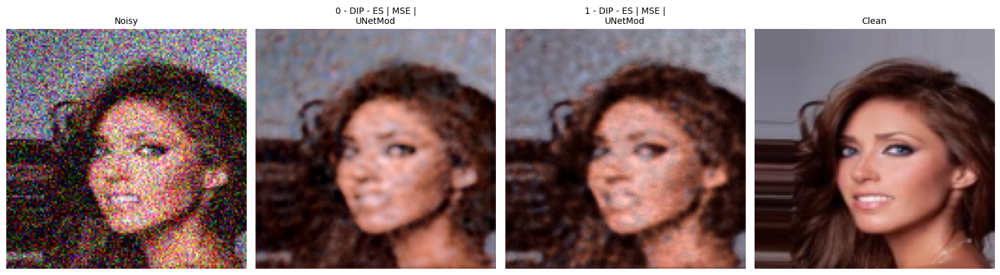

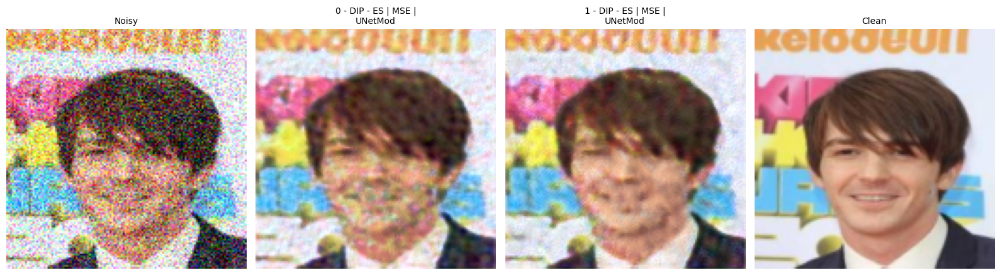

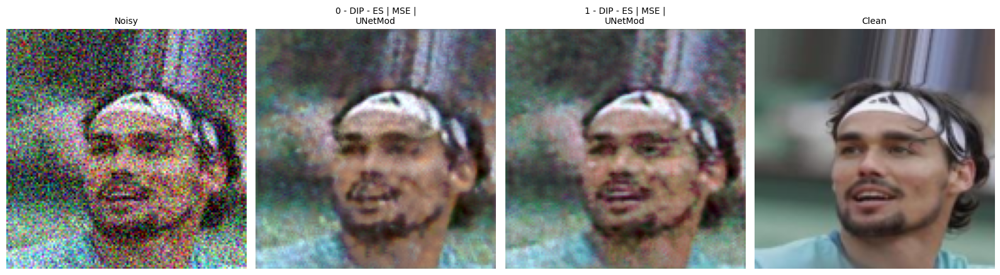

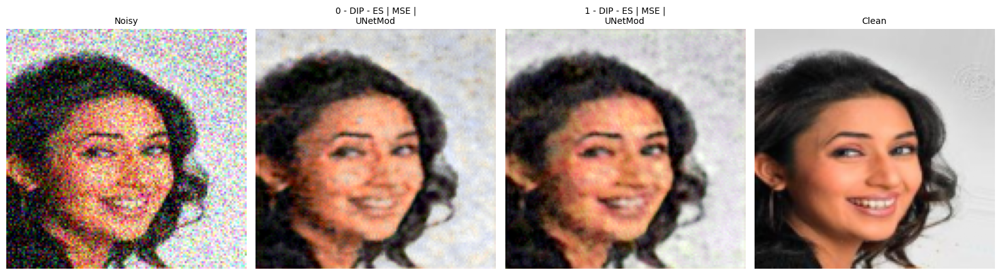

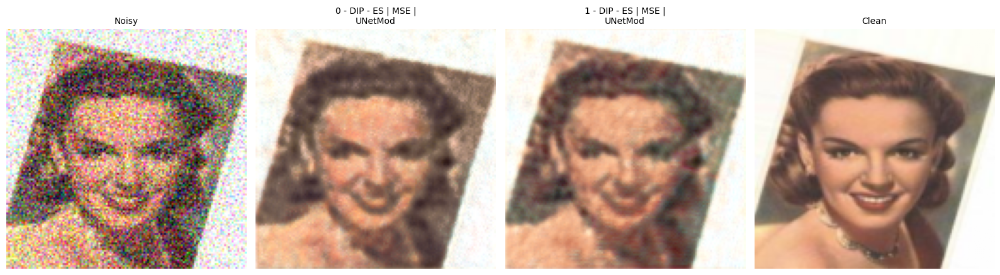

In [22]:
for result in zip(noisy, *results.values(), clean):
    utils.plot_row(result, ["Noisy", *list(results.keys()), "Clean"])

In [23]:
metrics = {
    "PSNR": PeakSignalNoiseRatio(data_range=2, reduction=None, dim=[1, 2, 3]),
    "SSIM": StructuralSimilarityIndexMeasure(data_range=2, reduction=None),
    # "LPIPS": LearnedPerceptualImagePatchSimilarity(),
}

for key, metric in metrics.items():
	print(key)
	print("----------")
	print(f"Noisy:".ljust(60), f"{metric(noisy, clean).mean()}")
	for name, xs in results.items():
		s = metric(xs, clean)
		print(f"{name}:".ljust(60), f"{s.mean()} ({s.std()})\t{s.tolist()}")
	print("\n")

PSNR
----------
Noisy:                                                       15.001640319824219
0 - DIP - ES | MSE | UNetMod :                               25.7143497467041 (0.9460853934288025)	[24.321245193481445, 26.17351531982422, 25.71831512451172, 24.595739364624023, 26.635366439819336, 26.515357971191406, 25.313682556152344, 25.32048225402832, 25.66823959350586, 26.283832550048828, 25.896730422973633, 26.51036834716797, 24.91194725036621, 25.337108612060547, 28.071163177490234, 25.977779388427734, 24.107900619506836, 25.119935989379883, 25.070911407470703, 26.737361907958984]
1 - DIP - ES | MSE | UNetMod :                               25.944225311279297 (0.8521126508712769)	[24.914518356323242, 26.3854923248291, 26.674474716186523, 25.200176239013672, 26.455957412719727, 25.81580924987793, 25.789825439453125, 25.017141342163086, 25.592458724975586, 27.120643615722656, 25.883209228515625, 27.28902816772461, 25.4926700592041, 25.001758575439453, 27.378934860229492, 26.51478004455

In [24]:
# import numpy as np

# names  = ["DIP-TV (ES)", "SG-DIP"]
# for name, x in zip(names, results.values()):
#     np.save(f"{name}.npy", x.numpy())